# TP1 - Vision par ordinateur

Importation des dépendances

In [1]:
import numpy as np
import cv2 as cv
import os
import matplotlib.pyplot as plt


from skimage.feature import graycomatrix, graycoprops
from skimage import io, color, img_as_float


## Data

Exemple

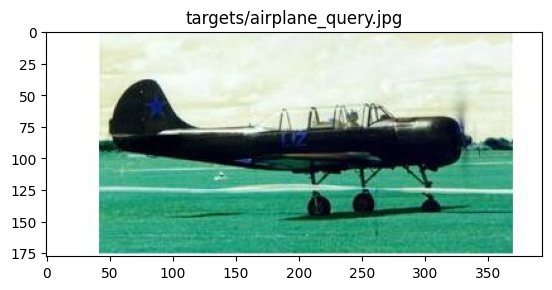

In [2]:
img_path = "data/targets/airplane_query.jpg"  
img = cv.imread(img_path)

#img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

# Utiliser matplotlib pour afficher l'image
plt.imshow(img)
plt.title(img_path[5:])
plt.show()

In [3]:
print(img.shape)

(178, 393, 3)


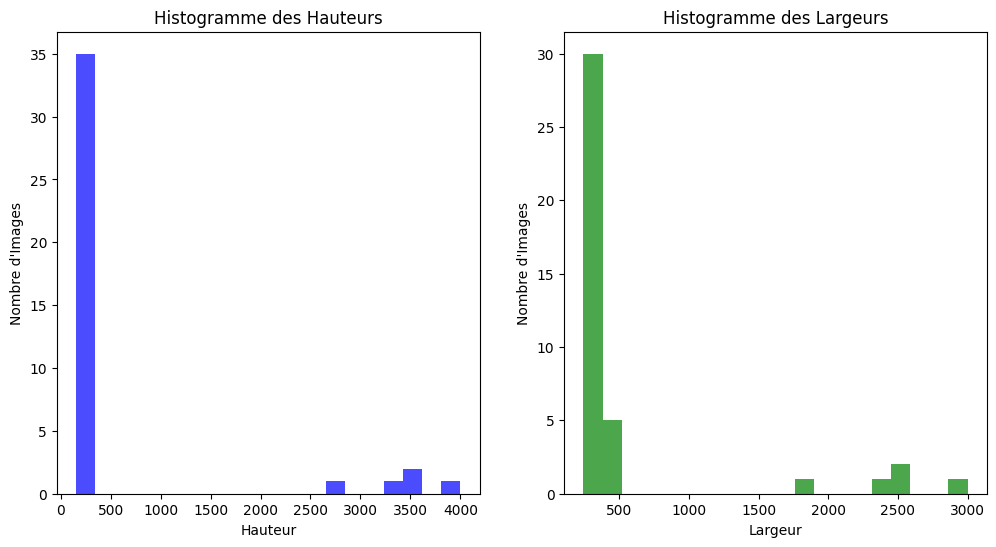

Taille moyenne :  (629.825, 572.8)
Rapport d'aspect moyen :  1.3330742064269494
Taille maximale :  (4000, 3000)
Taille minimale :  (160, 300)


In [4]:

data_path = 'data\\database'

sizes = []
aspect_ratios = []

for filename in os.listdir(data_path):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(data_path, filename)
        img = cv.imread(img_path)
        if img is not None:
            height, width = img.shape[:2]
            sizes.append((height, width))
            aspect_ratios.append(width / height)

# Calcul de la taille moyenne
mean_height = np.mean([size[0] for size in sizes])
mean_width = np.mean([size[1] for size in sizes])

# Identifier les tailles extrêmes
max_size = max(sizes, key=lambda x: x[0] * x[1])
min_size = min(sizes, key=lambda x: x[0] * x[1])

# Analyser les rapports d'aspect
mean_aspect_ratio = np.mean(aspect_ratios)

# Créer un histogramme des tailles
heights, widths = zip(*sizes)
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(heights, bins=20, color='blue', alpha=0.7)
plt.title('Histogramme des Hauteurs')
plt.xlabel('Hauteur')
plt.ylabel('Nombre d\'Images')

plt.subplot(1, 2, 2)
plt.hist(widths, bins=20, color='green', alpha=0.7)
plt.title('Histogramme des Largeurs')
plt.xlabel('Largeur')
plt.ylabel('Nombre d\'Images')

plt.show()

print("Taille moyenne : ", (mean_height, mean_width))
print("Rapport d'aspect moyen : ", mean_aspect_ratio)
print("Taille maximale : ", max_size)
print("Taille minimale : ", min_size)

## Objectif 

Pour chaque image requête, trouver les images similaires de la base d'images 

## Mérthodologie 

A ) Pour les deux méthodes :

    -Caractériser chaque image 

    -Utiliser des métriques pour comparer les images caractérisées 

    -Mesurer le temps de calcul et la précision 

B ) Comparer les meilleurs résulats des deux méthodes selon différents cas

    - Région uniforme

    - Motifs locaux importants

    - Information de couleur

    - Texture directionnelle 

## MC

Méthode :

- Une matrice par image 
- N matrice de la même image ( variation de la distance et de l'orientation)
- Fenêtre glissante (plus matrice pour différentes parties de l'image)

Statistique extrait des matricdes de co-occurrence :

- contrast: Measures the local variations in the GLCM.

- homogeneity: Measures the closeness of the distribution of elements in the GLCM to the GLCM diagonal.

- correlation: Measures the joint probability occurrence of the specified pixel pairs.

- energy: Sum of squared elements in the GLCM. Also known as 'angular second moment'.

- dissimilarity: Measures the variation of grey level pairs in the GLCM.

### Pré traitement

#### Redimensionnement 


Sans garder les proportions

In [5]:

def resize_image(image, target_size=(128, 128)):
    resized_image = cv.resize(image, target_size, interpolation=cv.INTER_AREA)
    return resized_image


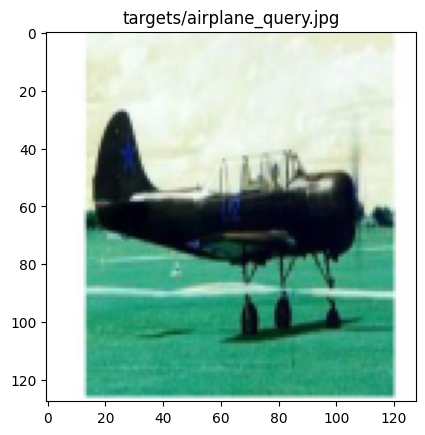

In [6]:

img_path = "data/targets/airplane_query.jpg"
image = cv.imread(img_path)
resized_image = resize_image(image)
plt.imshow(resized_image)
plt.title(img_path[5:])
plt.show()

En gardant les proportions

In [7]:

def resize_image_ratio(image, target_size=(128,128)):
    
    h, w = image.shape[:2]

    # Calculer le ratio et les nouvelles dimensions
    scale = min(target_size[0] / w, target_size[1] / h)
    new_w = int(w * scale)
    new_h = int(h * scale)

    # Redimensionner l'image
    resized_image = cv.resize(image, (new_w, new_h), interpolation=cv.INTER_AREA)

    return resized_image



In [8]:
image = cv.imread(img_path)
# Exemple d'utilisation
resized_image = resize_image_ratio(image, (128, 128))


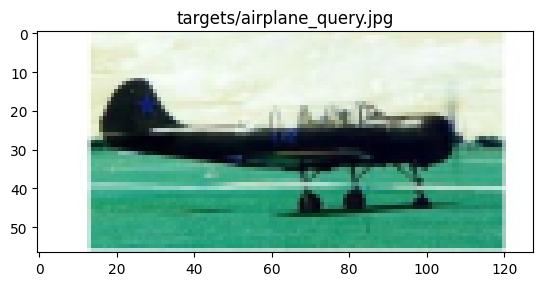

In [9]:
plt.imshow(resized_image)
plt.title(img_path[5:])
plt.show()

On obtient de meilleurs résultats avec de plus petites images 

### Fonction de match

Normalisation de la matrice

In [19]:
def normalize_glcm(glcm):
    total = np.sum(glcm)
    normalized_glcm = glcm / total
    return normalized_glcm

Mesures de similarité

In [10]:
def compare_images(reference_features, image_features, metric='euclidean'):
    if metric == 'euclidean':
        return np.linalg.norm(np.array(reference_features) - np.array(image_features))
    elif metric == 'manhattan':
        return np.sum(np.abs(np.array(reference_features) - np.array(image_features)))

Métrique d'évaluation

In [110]:
# Dossier contenant les images à comparer
data_path = 'data\\database'
targets_path = 'data\\targets'

def match(func): 
    
    t_match = 0
    f_match = 0
    
    images_features = []
    for filename in os.listdir(data_path):
        if filename.endswith(('.png', '.jpg', '.jpeg')):
            image_path = os.path.join(data_path, filename) 
            image_features,glcm = func(image_path)
            images_features.append((image_path, image_features,glcm))
        
    for q in os.listdir(targets_path) :
        target =os.path.join(targets_path, q)
        target_name = q.split("_query.jpg")[0]
       
        target_features,target_glcm = func(target)

        similarities = []
        for path,image_features,image_glcm in images_features:
            
            similarity = compare_images(target_features, image_features,"euclidean")
            if image_glcm != [] :
                similarity_glcm = compare_images(image_glcm,target_glcm,"euclidean")
                similarity = (similarity_glcm + similarity ) /2
                print("Yes")
            
            similarities.append((path, similarity))

        # Trier les images par similarité
        similarities.sort(key=lambda x: x[1])

        img_q = io.imread(target)
        plt.imshow(img_q)
        plt.title(f"target")
        # Afficher les 3 images les plus similaires
        
        plt.figure(figsize=(15, 5))
        
        for i, (path, _) in enumerate(similarities[:3]):
            image_name =  path.split('\\')[-1]
            image_name = image_name.split("_")[0]

            if image_name == target_name :
                t_match += 1
            else :
                f_match += 1
            
            image = io.imread(path)
            plt.subplot(1, 3, i+1)
            plt.imshow(image)
            plt.title(f"Image {path[5:]}")
            plt.axis('off')

        plt.show()
        
    return t_match+f_match, t_match, f_match


### Une matrice par image

#### Comparaison des caractéristiques

In [117]:
from skimage.color import rgb2gray

def calculate_1_glcm_features(image_path):
    """ Calcule les caractéristiques GLCM d'une image. """
    image = io.imread(image_path)
    image = img_as_float(image)  #Normalisation
    # Vérifiez si l'image est en couleur (3 canaux)
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray_image = rgb2gray(image)
    else:
        gray_image = image  # l'image est déjà en niveaux de gris
    gray_image = (gray_image * 255).astype('uint8')

    glcm = graycomatrix(gray_image, distances=[1], angles=[0], levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, prop='contrast')[0, 0]
    homogeneity = graycoprops(glcm, prop='homogeneity')[0, 0]
    correlation = graycoprops(glcm, prop='correlation')[0, 0]
    energy = graycoprops(glcm, prop='energy')[0, 0]
    dissimilarity = graycoprops(glcm, prop='dissimilarity')[0, 0]

    return (contrast, homogeneity,correlation,energy,dissimilarity), []




### Test 1


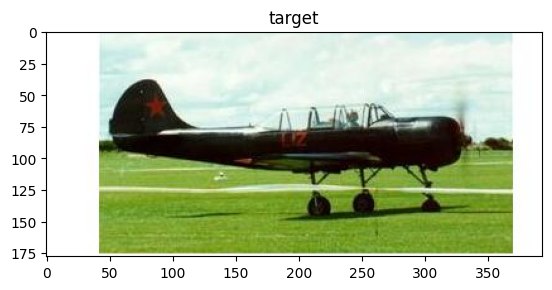

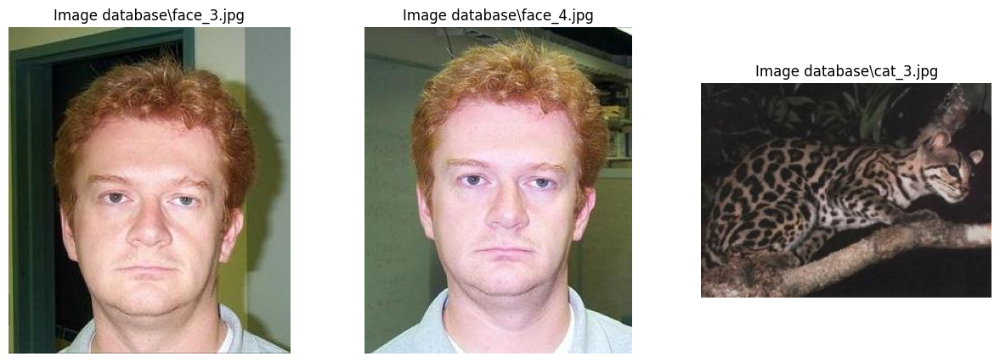

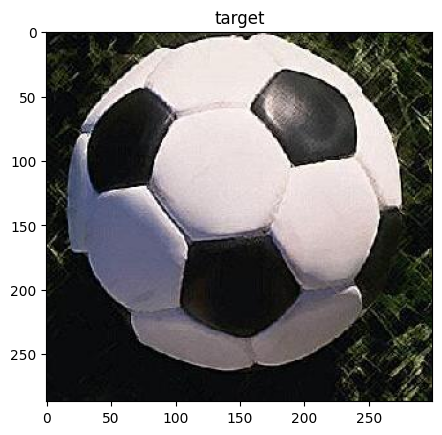

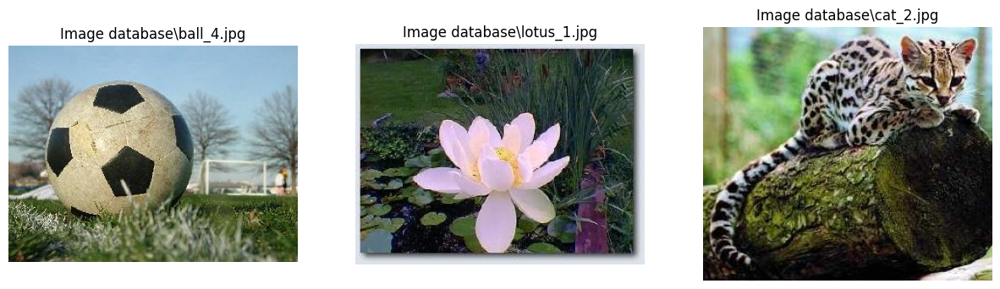

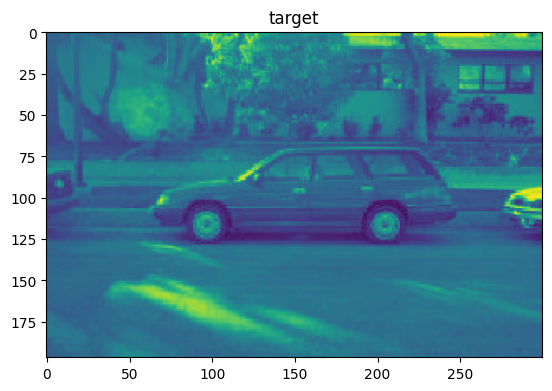

...

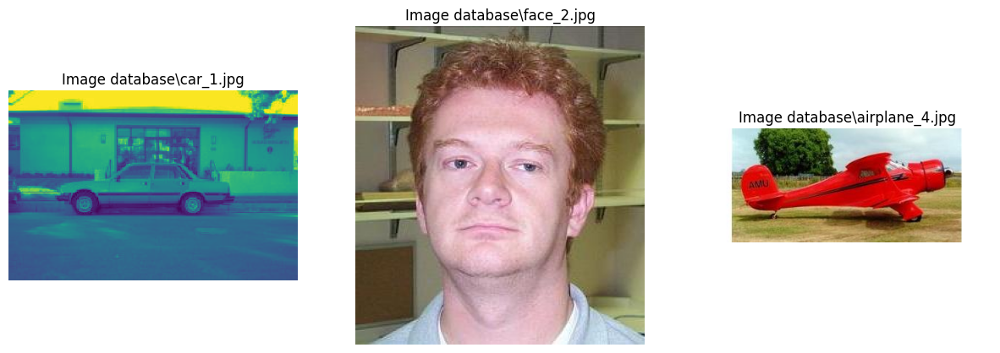

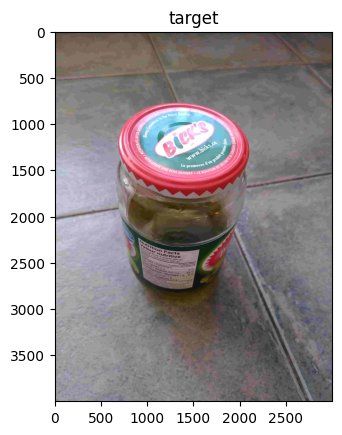

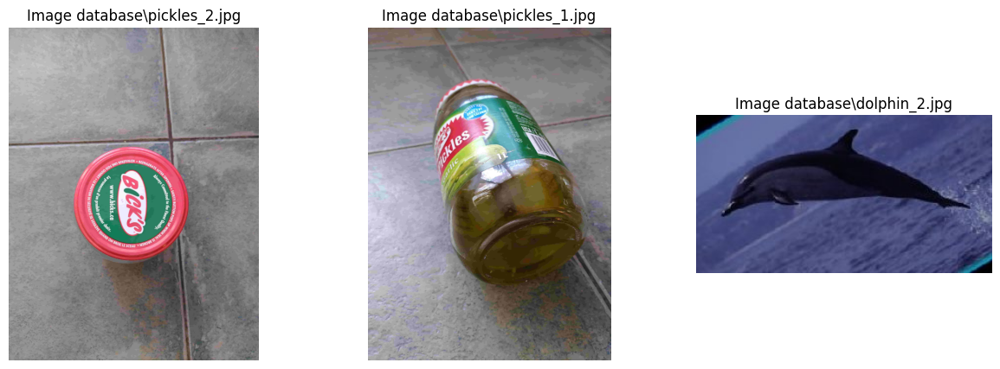

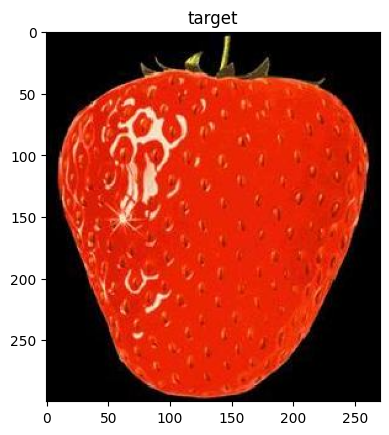

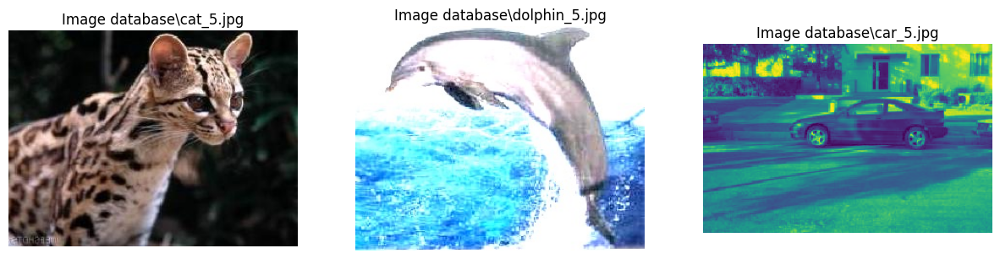

In [79]:
tot,t,f = match(calculate_1_glcm_features)

In [80]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 4
Précision = 0.14814814814814814


#### Comparaison des matrices de co-occurrence

In [118]:
from skimage.color import rgb2gray

def calculate_glcm(image_path):
    """ Calcule les caractéristiques GLCM d'une image. """
    image = io.imread(image_path)
    image = img_as_float(image)  #Normalisation
    # Vérifiez si l'image est en couleur (3 canaux)
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray_image = rgb2gray(image)
    else:
        gray_image = image  # l'image est déjà en niveaux de gris
    gray_image = (gray_image * 255).astype('uint8')

    glcm = graycomatrix(gray_image, distances=[1], angles=[0], levels=256, symmetric=True, normed=True)
    glcm = normalize_glcm(glcm)
    return glcm, []




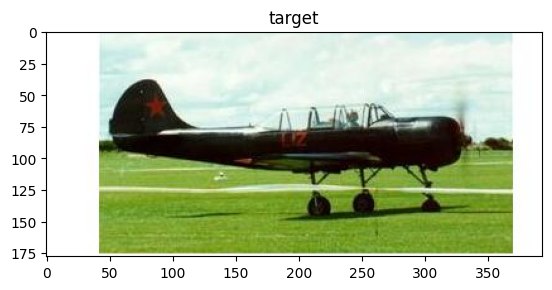

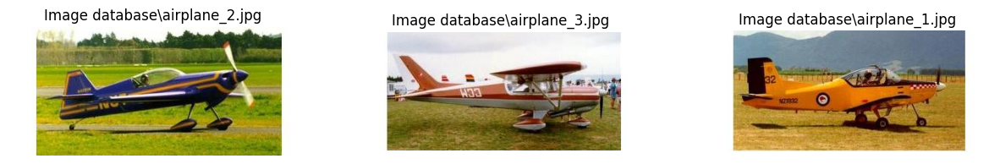

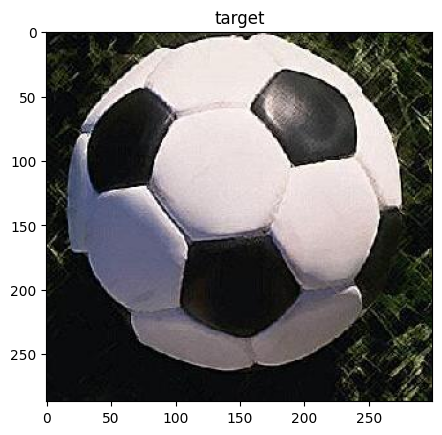

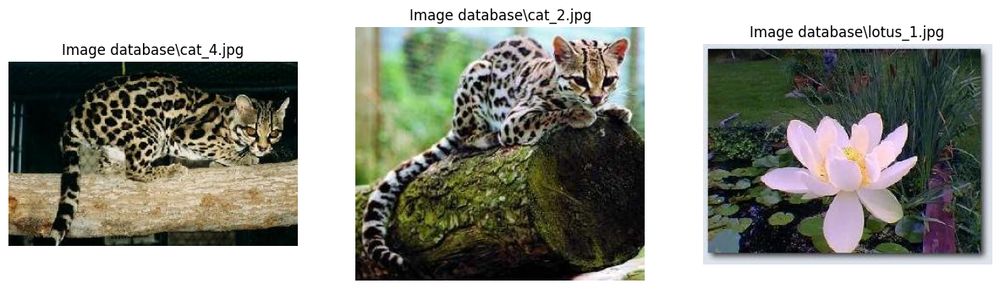

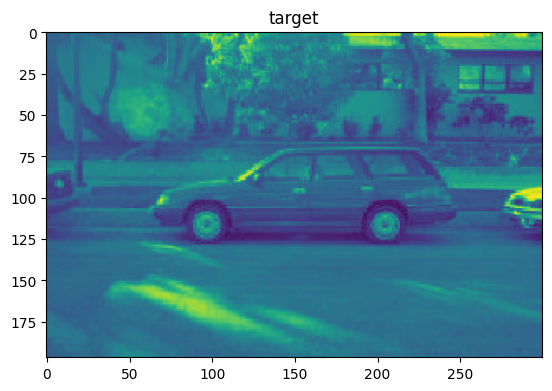

...

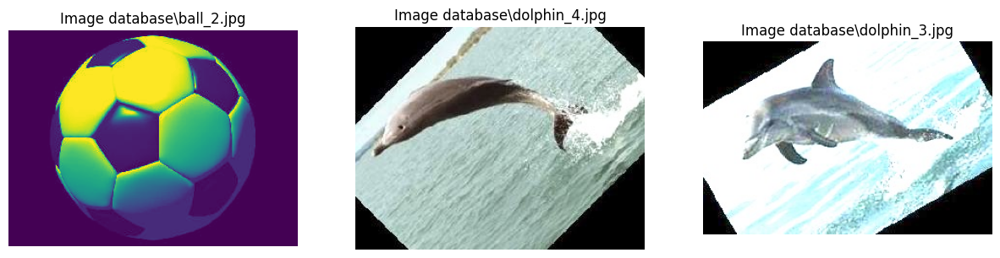

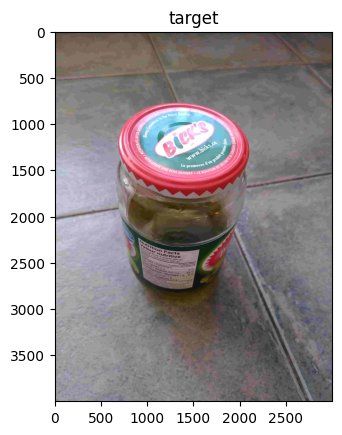

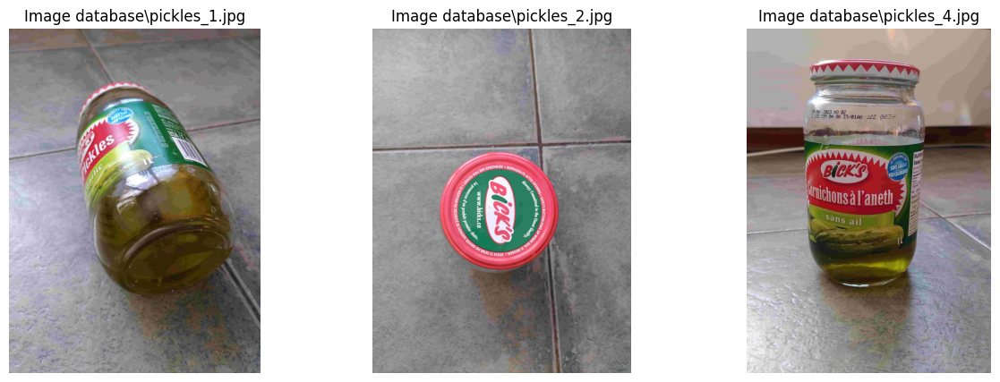

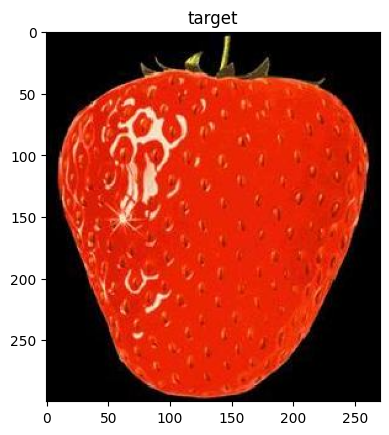

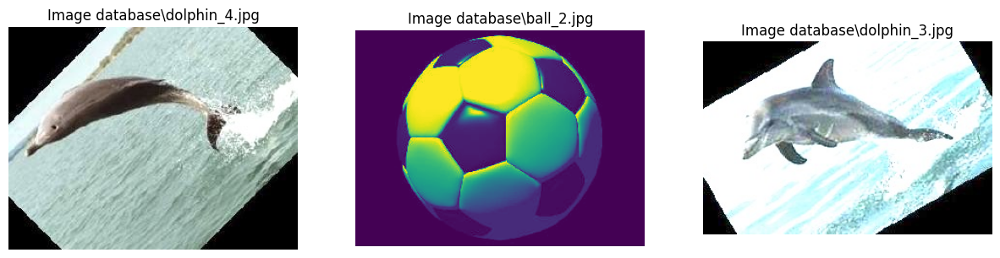

In [119]:
tot,t,f = match(calculate_glcm)

In [120]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 10
Précision = 0.37037037037037035


### Plusieurs Matrices Co-occurrence

In [111]:
def compute_features(image,distances,angles):
    features = []
    glcms = []
    combined_glcm = 0
    for distance in distances:
        for angle in angles:
            glcm = graycomatrix(image, distances=[distance], angles=[angle], levels=256, symmetric=True, normed=True)
            #glcm = normalize_glcm(glcm)
            glcms.append(glcm)
            
            features.append(graycoprops(glcm, prop='contrast')[0, 0])
            features.append(graycoprops(glcm, prop='homogeneity')[0, 0])
            features.append(graycoprops(glcm, prop='correlation')[0, 0])
            features.append(graycoprops(glcm, prop='energy')[0, 0])
            features.append(graycoprops(glcm, prop='dissimilarity')[0, 0])
    
    print(combined_glcm)
    return features, glcms

In [112]:

def calculate_glcm_features(image_path):
    """ Calcule les caractéristiques GLCM d'une image pour différentes distances et angles. """
    image = io.imread(image_path)
    #image = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    image = img_as_float(image)  #Normalisation
    #image = resize_image(image)
    image = resize_image_ratio(image)
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray_image = color.rgb2gray(image)
    else:
        gray_image = image
    gray_image = (gray_image * 255).astype('uint8')

    distances = [1, 2]  # de 1, 2, 3 pixels
    angles = [0, np.pi/4]
    #angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]  #  angles 0, 45, 90 et 135 degrés

    features,glcms = compute_features(gray_image,distances,angles)

    return features,glcms




### Test 2

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


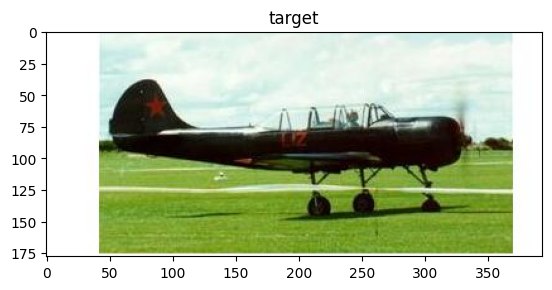

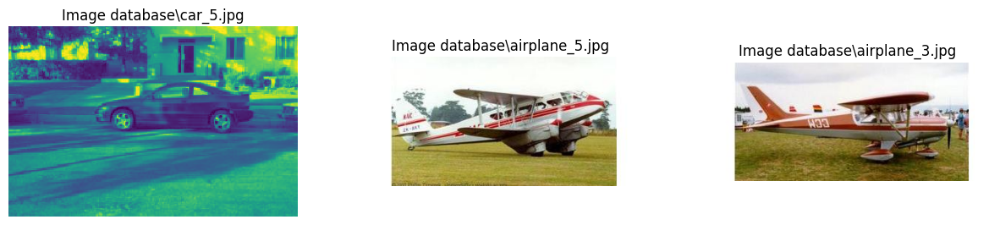

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


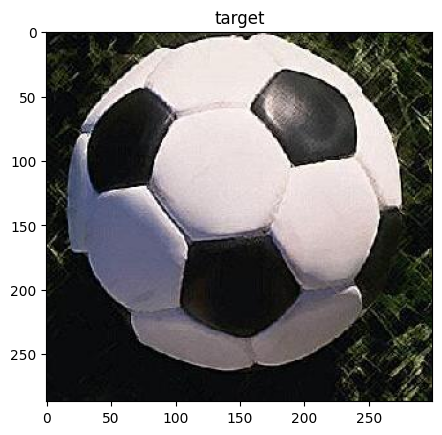

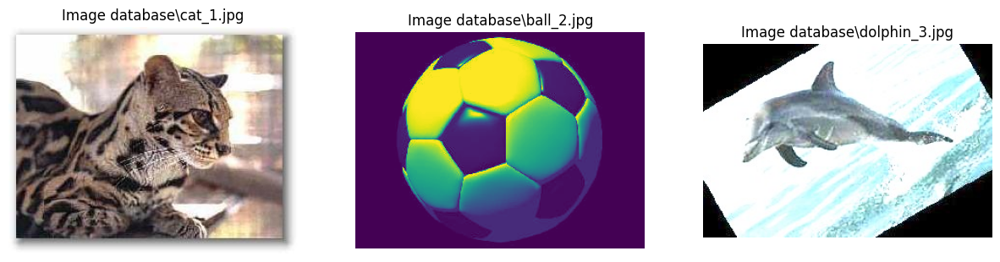

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


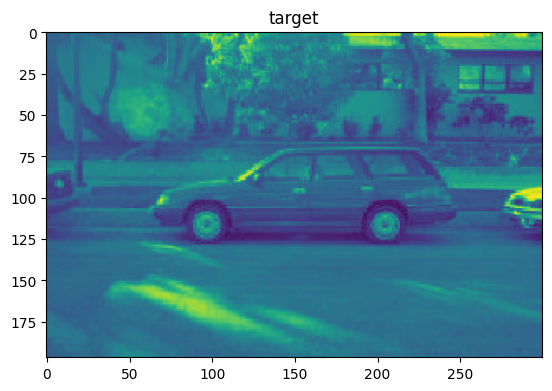

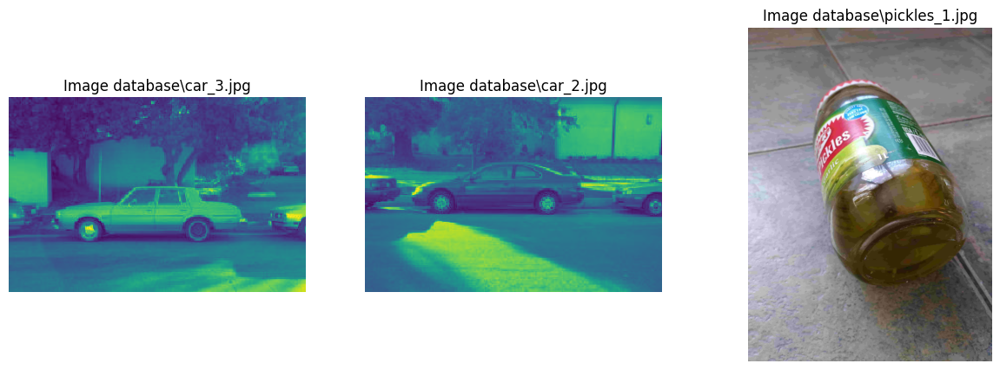

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


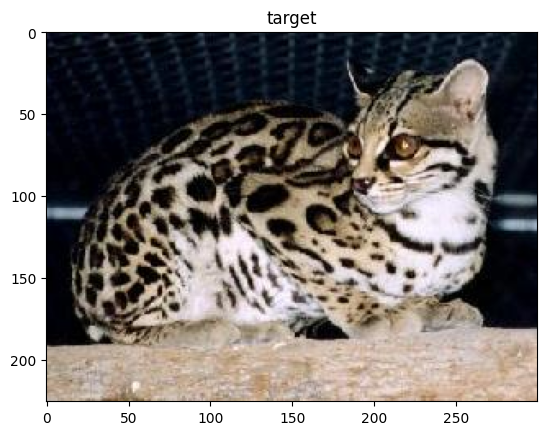

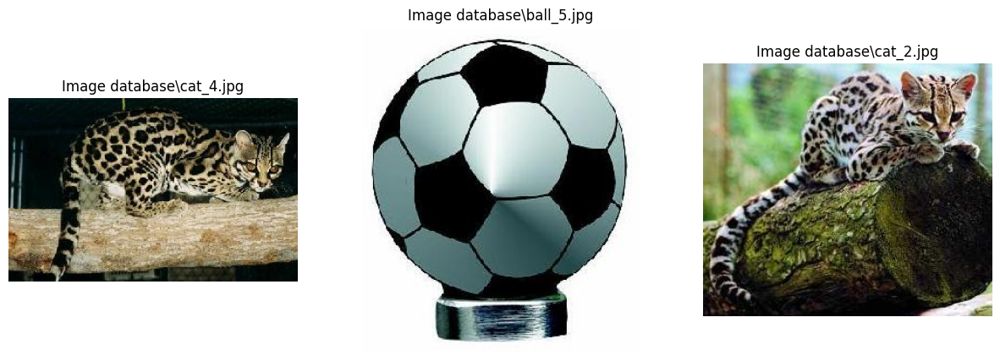

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


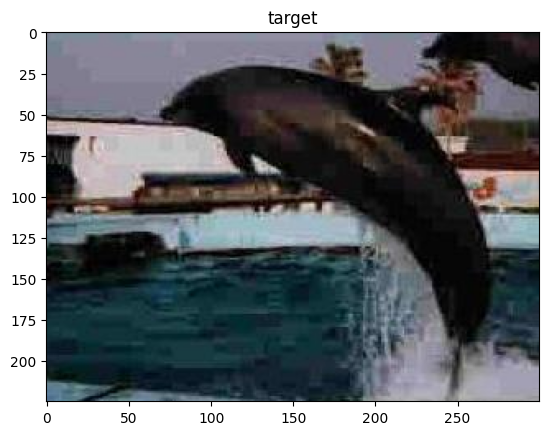

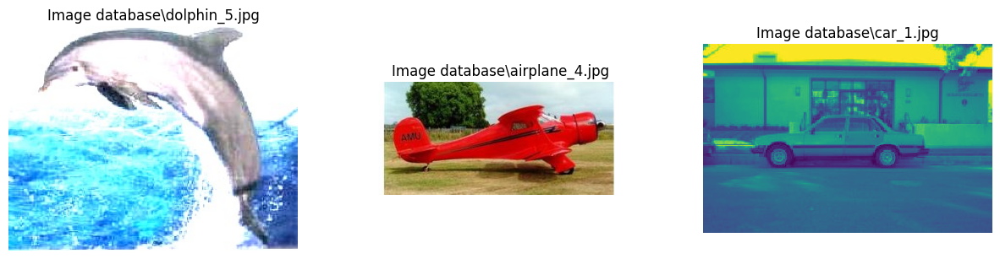

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


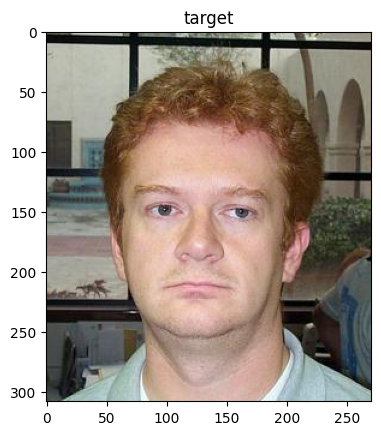

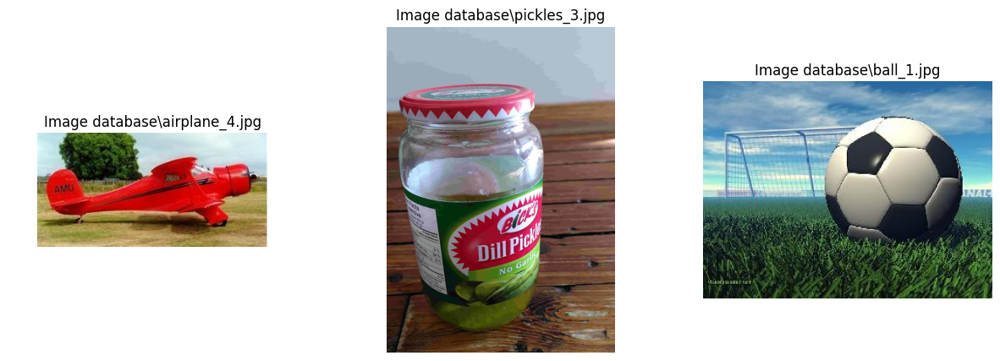

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


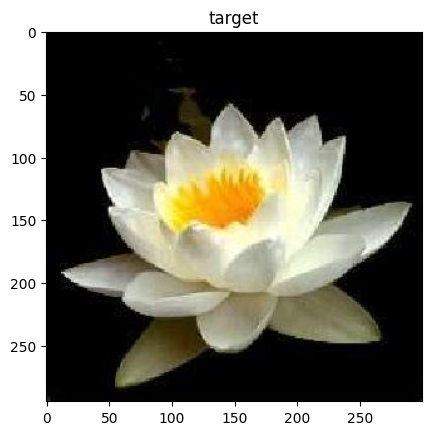

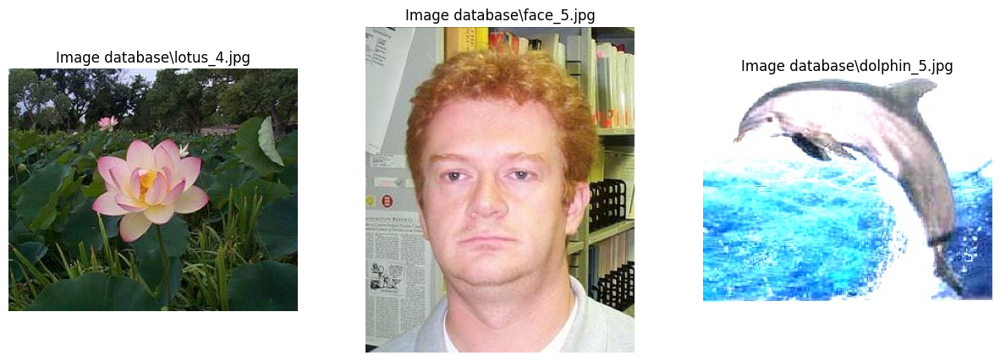

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


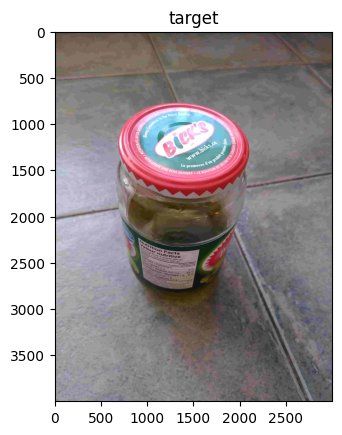

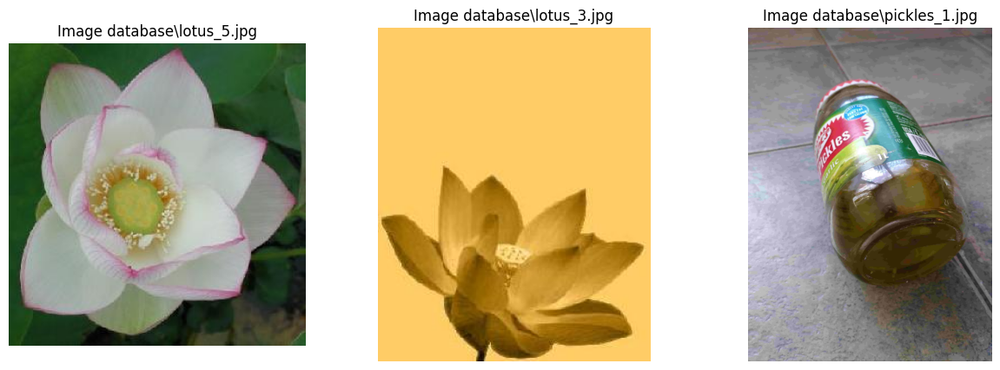

0
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes
Yes


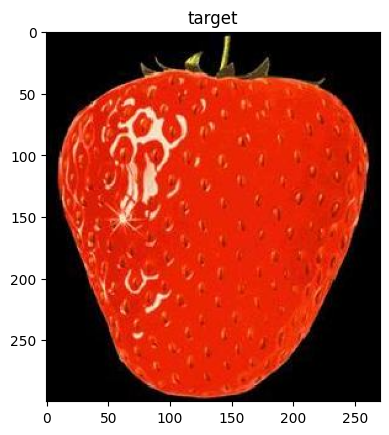

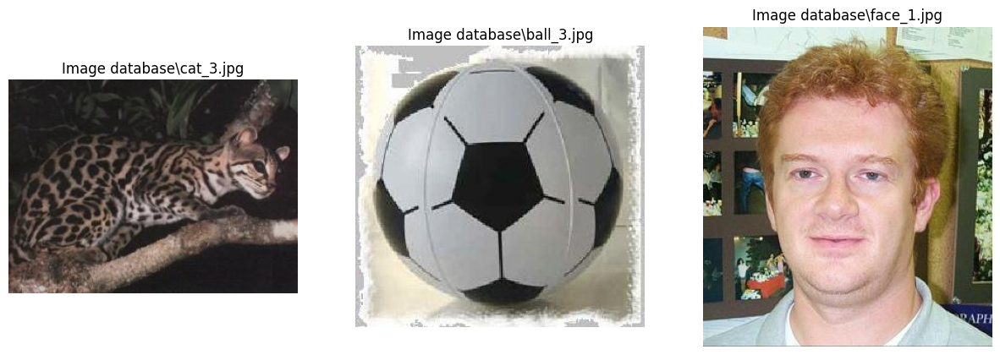

In [113]:
tot,t,f = match(calculate_glcm_features)

In [114]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 9
Précision = 0.3333333333333333


- Lorsqu'on augmente les distances des pixels on obtient de moins bons résulats, les raisons potentielles : perte de Détails Locaux, davantage de bruit, diminution de la corrélation spatiale.

        avec [1,2,36,8] -> p = 0.15

        avec [1,2] -> p = 0.259

- Pour les angles, les meilleurs résulats sont obtenus pour 0° et 45°, les raisons potentielles : les angles atypiques tels que 60° et 120° peuvent capturer plus de bruit avec des images de mauvaises qualités, l'ajout d'angles peuvent ajouter des informations redondantes.

        avec [0°, 45°] -> p = 0.259

        avec [0°, 45°, 90°, 135°] -> p=0.259

        avec [0°, 45°,60°, 90°, 120°, 135°] -> p= 0.20
- La normalisation améliore un peu ( passant de 0.25 à 0.29)

- Le redimensionnement sans garder les ratios réduit beaucoup les résulats (0.29 à 0.18)

- Le redimensionnement en garder les ratios améliore un peu les résulats (0.29 à 0.33)  (on rarque qu'il est mieux de garder certaines dimensions, par exemple pour l'avion)

- En utilisant la distance de Manhattan, on obtient de moins bons résultats ( il remplace un ballon contre un chat)

### Fenêtre glissante 

In [123]:



def calculate_windows_glcm_features(image_path):
    print(image_path)
    image = io.imread(image_path)
    image = img_as_float(image) 
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray_image = color.rgb2gray(image)
    else:
        gray_image = image
    gray_image = (gray_image * 255).astype('uint8')

    distances = [1, 2]  # de 1, 2, 3 pixels
    angles = [0, np.pi/4]
    
    #Paramètres window
    height, width = gray_image.shape
    window_size = max(height, width) // 20  # 10% de la plus grande dimension
    stride = window_size // 2  #  50% de la taille de la fenêtre
    features_all_windows = []
    
    
    for y in range(0, height - window_size + 1, stride):  # stride est le pas de la fenêtre
        for x in range(0, width - window_size + 1, stride):
            
            window = gray_image[y:y+window_size, x:x+window_size]
            #features = compute_features(window,distances,angles)
            glcm = graycomatrix(window, distances=[1], angles=[0], levels=256, symmetric=True, normed=True)
            glcm = normalize_glcm(glcm)
            
            features_all_windows.append(glcm)
    print("FINISh--------------")       
    final_features = np.mean(features_all_windows, axis=0)

    return final_features, []




### Test 3

data\database\airplane_1.jpg
FINISh--------------
data\database\airplane_2.jpg
FINISh--------------
data\database\airplane_3.jpg
FINISh--------------
data\database\airplane_4.jpg
FINISh--------------
data\database\airplane_5.jpg
FINISh--------------
data\database\ball_1.jpg
FINISh--------------
data\database\ball_2.jpg
FINISh--------------
data\database\ball_3.jpg
FINISh--------------
data\database\ball_4.jpg
FINISh--------------
data\database\ball_5.jpg
FINISh--------------
data\database\car_1.jpg
FINISh--------------
data\database\car_2.jpg
FINISh--------------
data\database\car_3.jpg
FINISh--------------
data\database\car_4.jpg
FINISh--------------
data\database\car_5.jpg
FINISh--------------
data\database\cat_1.jpg
FINISh--------------
data\database\cat_2.jpg
FINISh--------------
data\database\cat_3.jpg
FINISh--------------
data\database\cat_4.jpg
FINISh--------------
data\database\cat_5.jpg
FINISh--------------
data\database\dolphin_1.jpg
FINISh--------------
data\database\dolphin

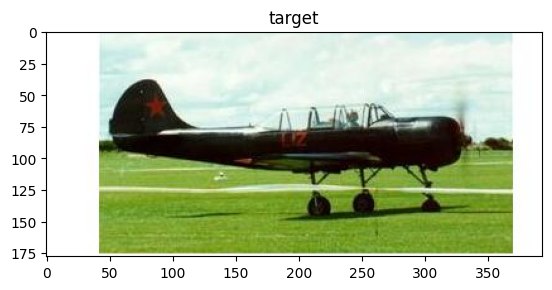

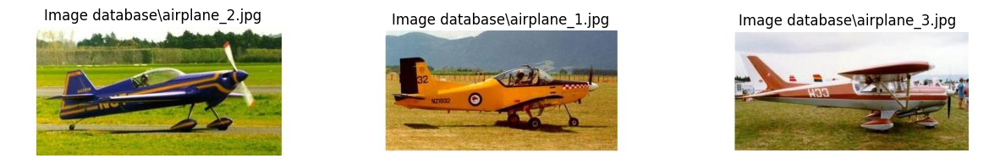

data\targets\ball_query.jpg
FINISh--------------


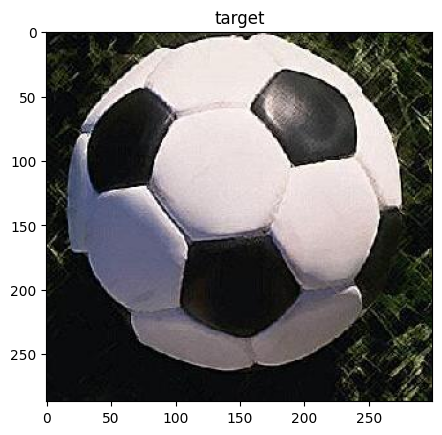

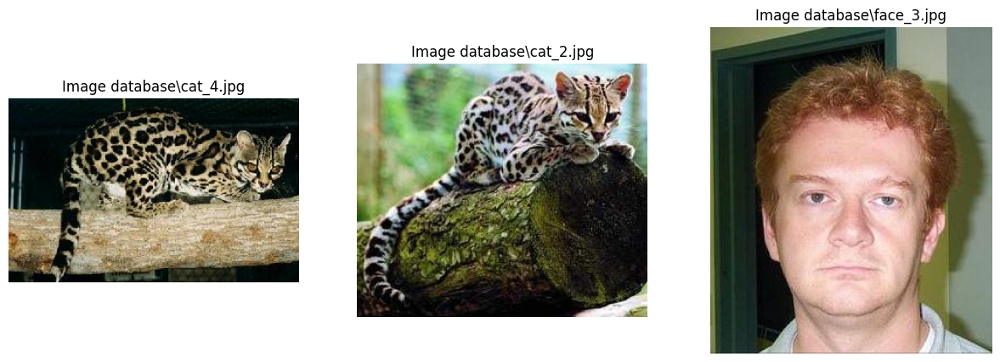

data\targets\car_query.jpg
FINISh--------------


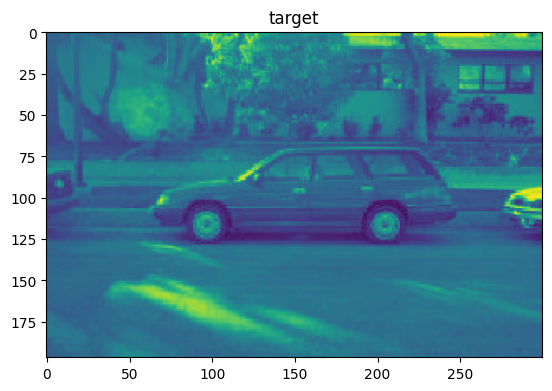

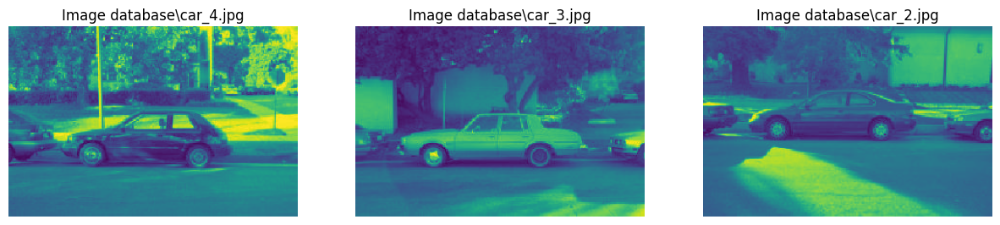

data\targets\cat_query.jpg
FINISh--------------


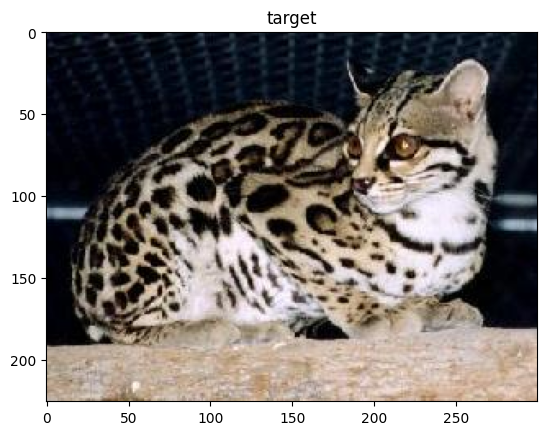

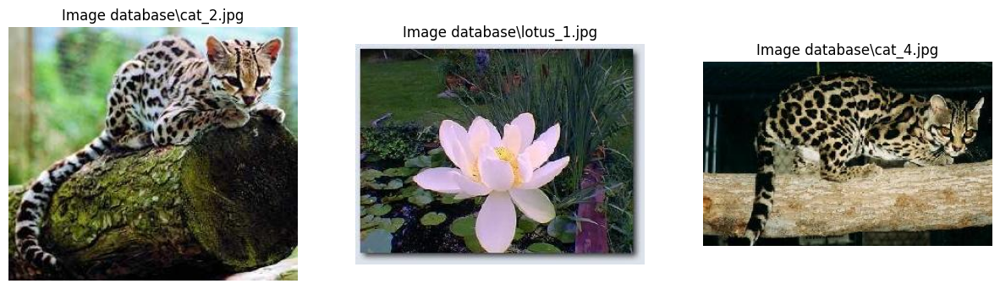

data\targets\dolphin_query.jpg
FINISh--------------


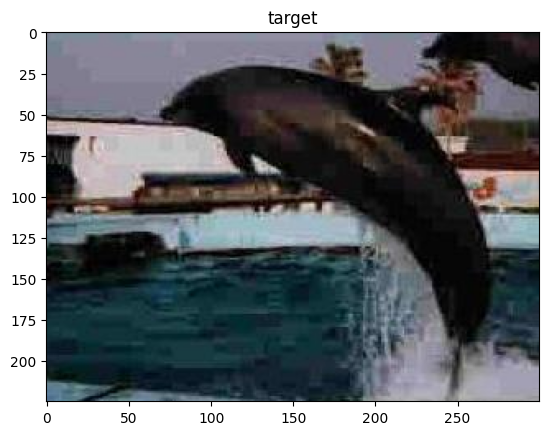

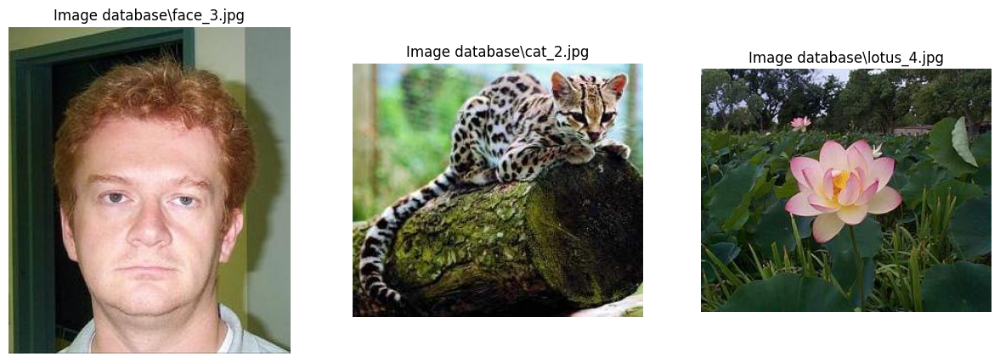

data\targets\face_query.jpg
FINISh--------------


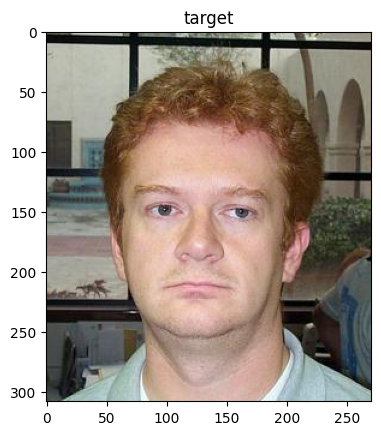

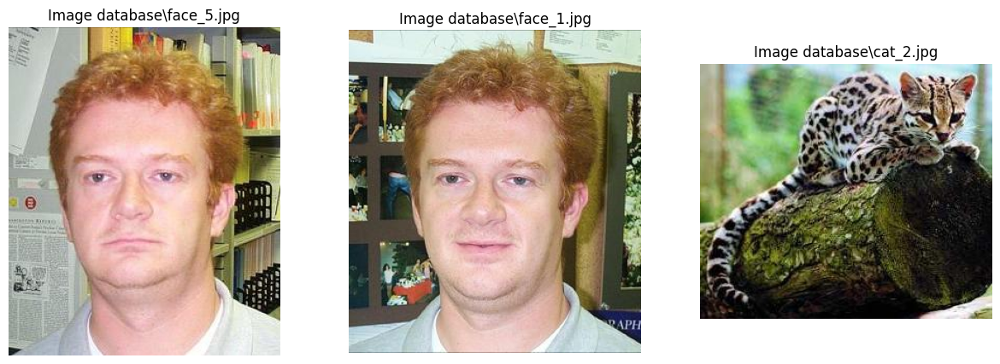

data\targets\lotus_query.jpg
FINISh--------------


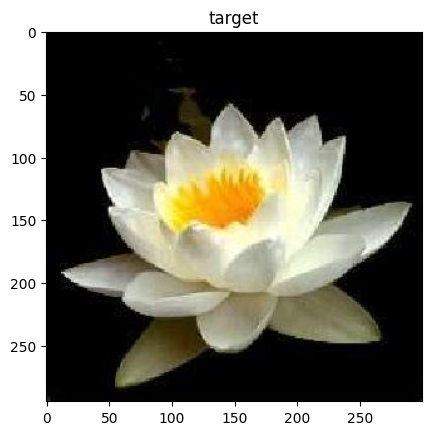

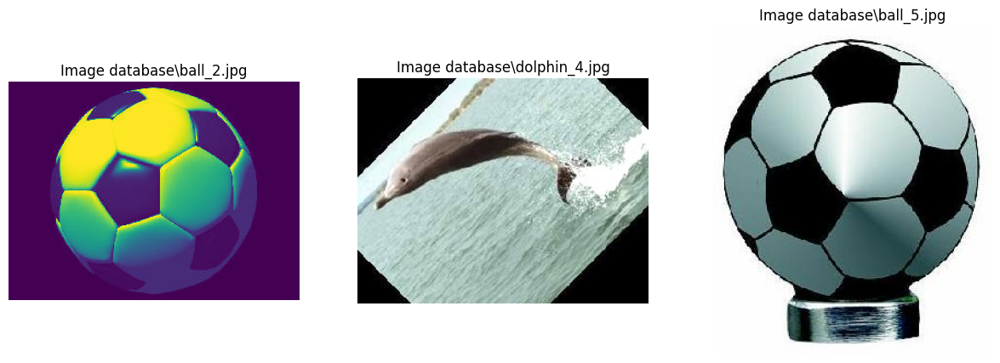

data\targets\pickles_querry.jpg
FINISh--------------


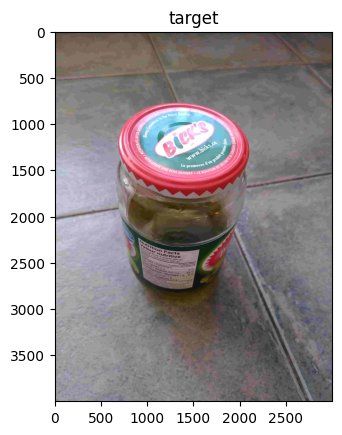

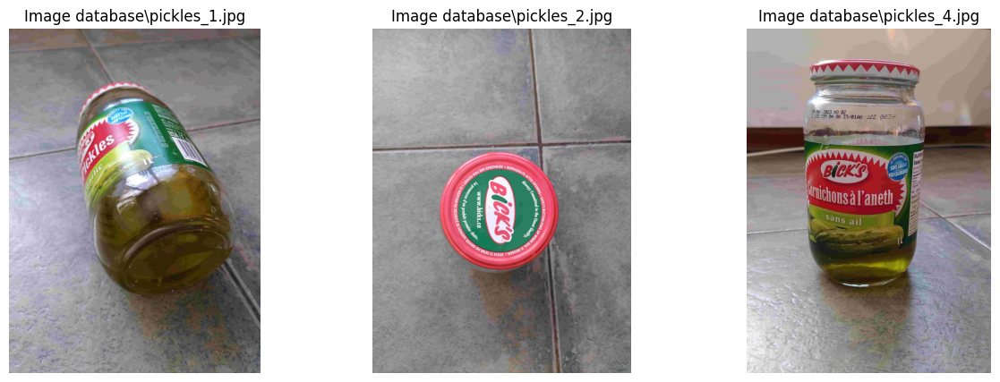

data\targets\strawberry_query.jpg
FINISh--------------


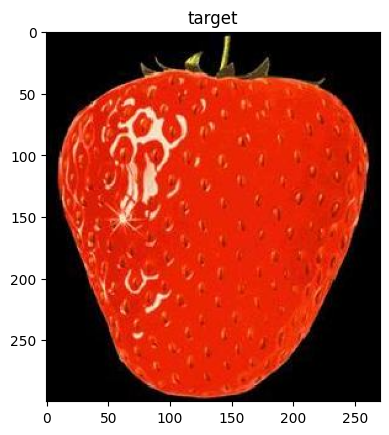

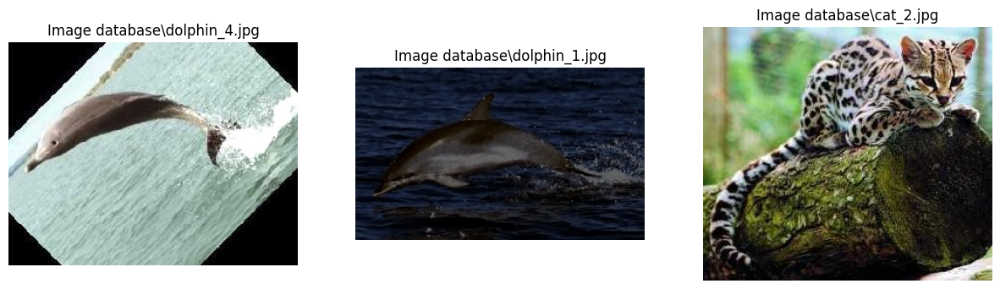

In [124]:
tot,t,f = match(calculate_windows_glcm_features)

In [125]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 10
Précision = 0.37037037037037035


### Prise en compte des canaux de couleurs

In [176]:

def compute_channel_features(channel, distances, angles):
    """ Calcule les caractéristiques GLCM pour un seul canal de couleur. """
    channel = (channel * 255).astype('uint8')
    features = []
    glcm = graycomatrix(channel, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)
    features.append(graycoprops(glcm, prop='contrast')[0, 0])
    features.append(graycoprops(glcm, prop='homogeneity')[0, 0])
    features.append(graycoprops(glcm, prop='correlation')[0, 0])
    features.append(graycoprops(glcm, prop='energy')[0, 0])
    features.append(graycoprops(glcm, prop='dissimilarity')[0, 0])
    return features

def calculate_channel_glcm_features(image_path):  
    """ Calcule les caractéristiques GLCM pour chaque canal de couleur d'une image. """
    image = io.imread(image_path)
    
    
    if len(image.shape) == 3 and image.shape[2] == 3:
        # Séparer les canaux de couleur
        red_channel, green_channel, blue_channel = image[:, :, 0], image[:, :, 1], image[:, :, 2]
    else:
        # Pour les images en niveaux de gris, traiter le canal unique
        red_channel = green_channel = blue_channel = image

    distances = [1, 2]
    angles = [0, np.pi/4]

    # Calculer les caractéristiques pour chaque canal
    features_red = compute_channel_features(red_channel, distances, angles)
    features_green = compute_channel_features(green_channel, distances, angles)
    features_blue = compute_channel_features(blue_channel, distances, angles)

    # Fusionner les caractéristiques de tous les canaux
    features = features_red + features_green + features_blue

    return features


airplane
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\airplane_3.jpg', 162.49476722575298), ('data\\database\\ball_4.jpg', 365.26169556479755), ('data\\database\\face_5.jpg', 369.02871960350564)]


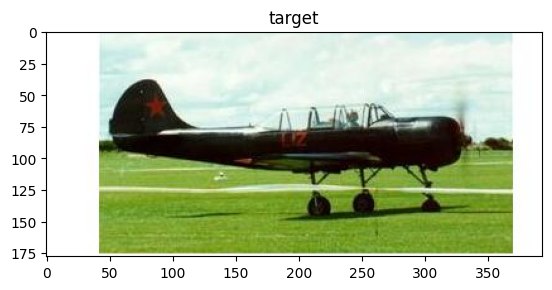

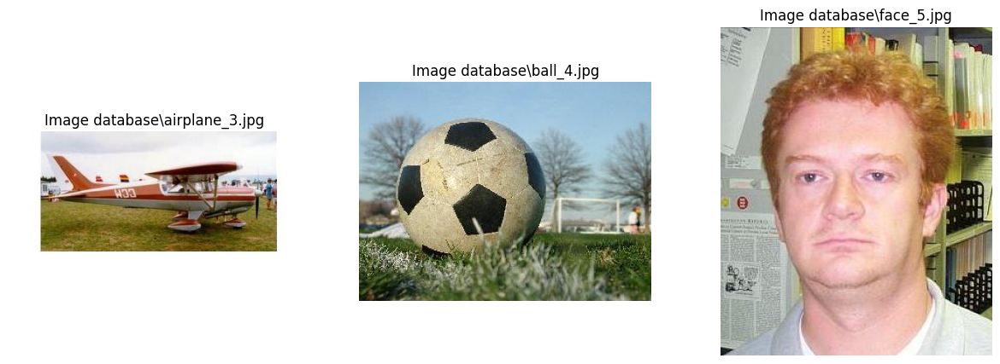

ball
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_2.jpg', 1062.9942497552602), ('data\\database\\ball_1.jpg', 1190.1210047984707), ('data\\database\\lotus_4.jpg', 1664.7671643351323)]


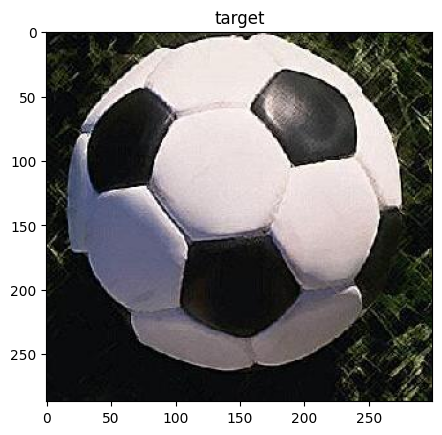

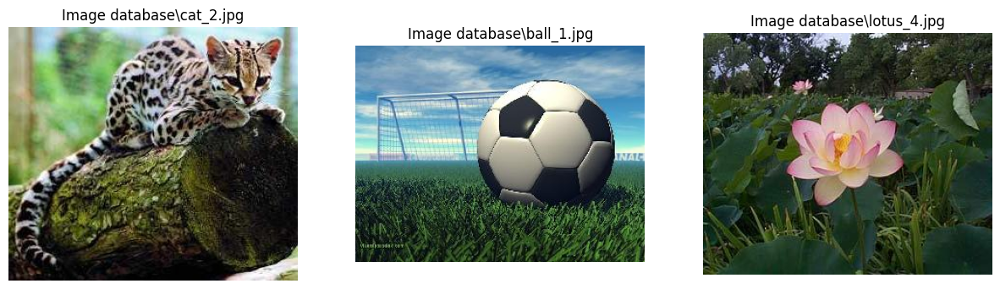

car
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\car_2.jpg', 5.083879916526207), ('data\\database\\car_3.jpg', 17.519570738011314), ('data\\database\\pickles_4.jpg', 39.35758969783388)]


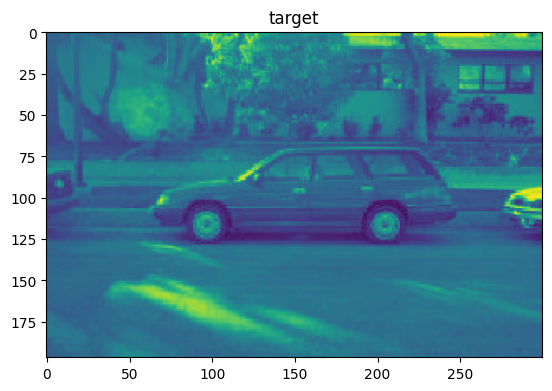

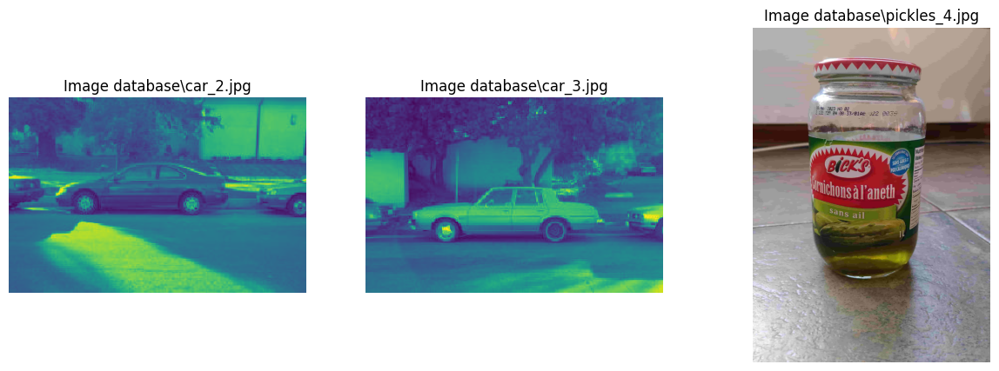

cat
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\ball_5.jpg', 1136.0013097320912), ('data\\database\\ball_1.jpg', 2497.548128639159), ('data\\database\\cat_4.jpg', 2774.2307313944093)]


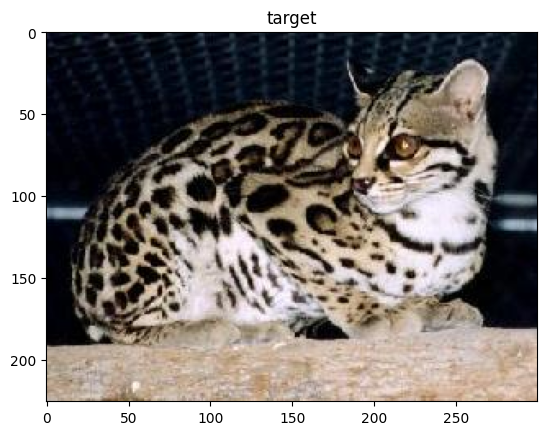

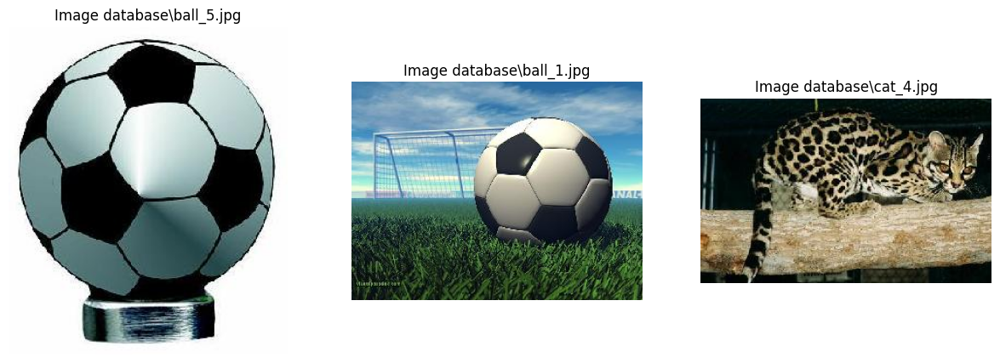

dolphin
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_5.jpg', 396.84039760499667), ('data\\database\\face_1.jpg', 401.9709369585705), ('data\\database\\cat_1.jpg', 414.4705840268469)]


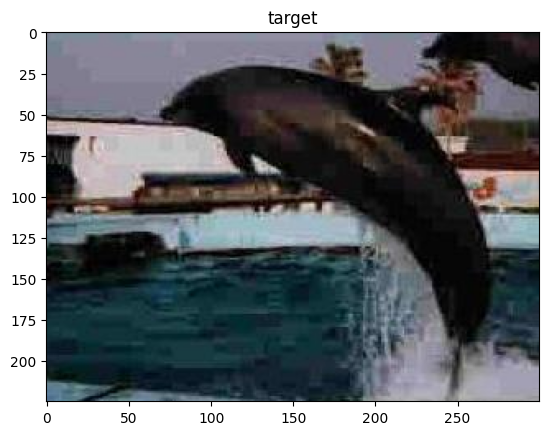

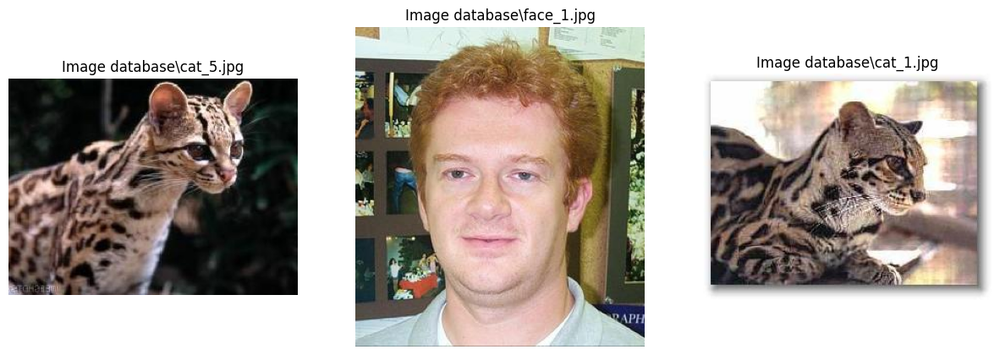

face
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_3.jpg', 62.03327315424418), ('data\\database\\car_4.jpg', 126.78746497941573), ('data\\database\\lotus_2.jpg', 136.39004152744965)]


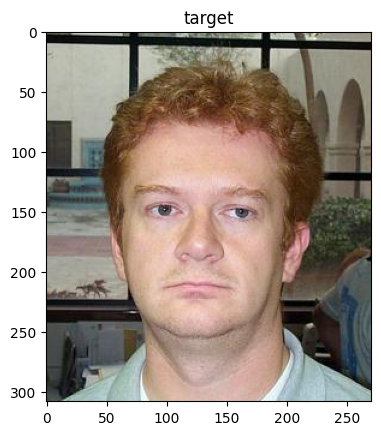

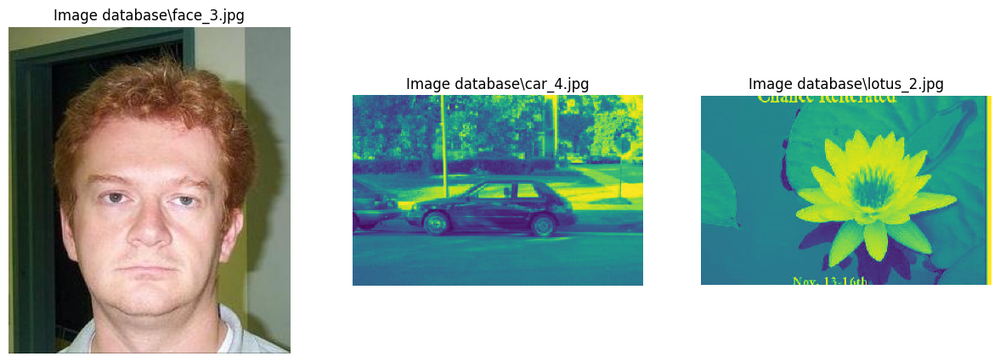

lotus
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\ball_5.jpg', 1291.3266235392541), ('data\\database\\ball_2.jpg', 1512.4512767496146), ('data\\database\\cat_2.jpg', 1565.5337070579935)]


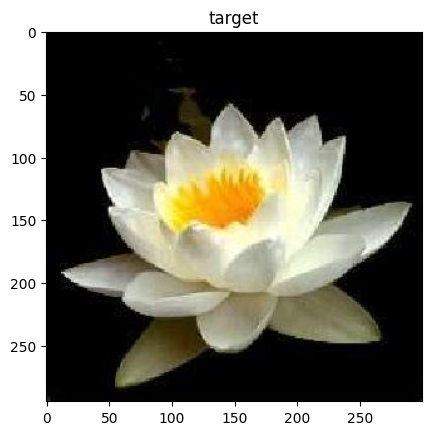

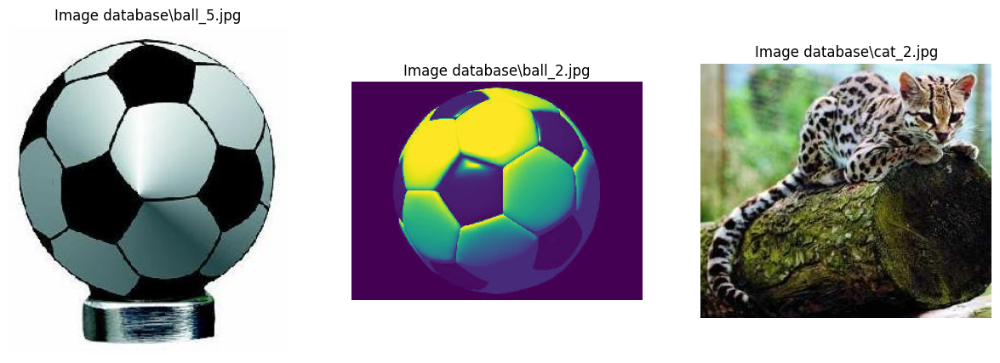

pickles_querry.jpg
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\pickles_2.jpg', 12.285979145139454), ('data\\database\\pickles_1.jpg', 26.730943464140573), ('data\\database\\car_2.jpg', 95.72004334507814)]


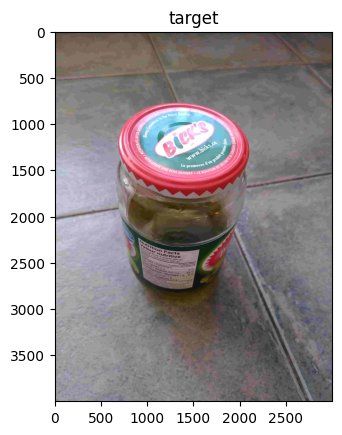

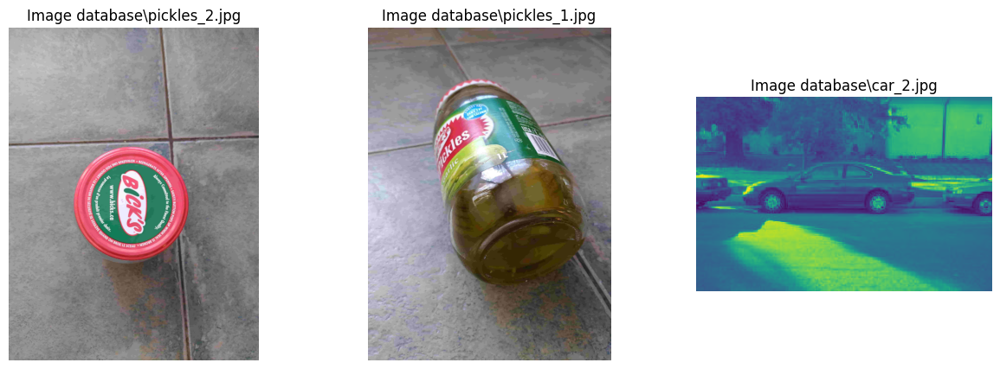

strawberry
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_2.jpg', 4499.624364604136), ('data\\database\\airplane_2.jpg', 5177.75114099939), ('data\\database\\cat_4.jpg', 5516.150746374283)]


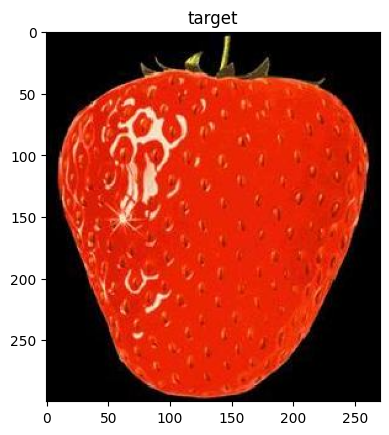

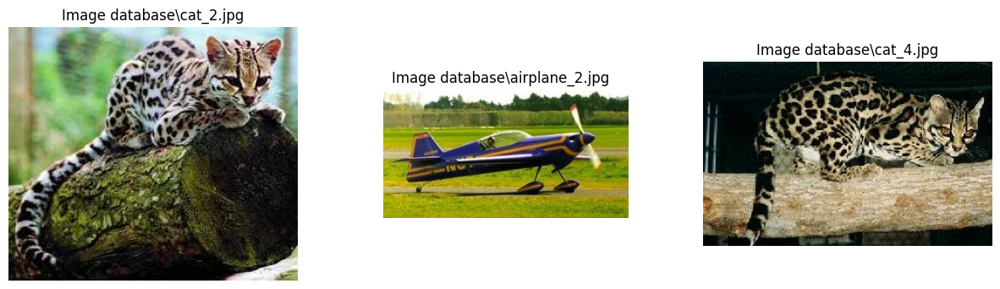

In [177]:
tot,t,f = match(calculate_channel_glcm_features)

In [178]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 6
Précision = 0.2222222222222222


On obtient de moins bonne performance qu'en travaillant sur les niveaux de gris

La normalisation n'aide pas lorsqu'on traite les couleurs